In [1]:
import os

basefiles = ["trans_cis_eqtl_enrichment.txt", "trans_eqtls_enrichment.txt", 
             "trans_not_cis_eqtl_enrichment.txt"]

basedir = "/cbscratch/franco/trans-eqtl/dev-pipeline/gtex_v8_SHAPEIT2_032021_rev_freeze/raw/summary_dev/"
dhstypes = ["dhsindex", "dhsmulti"]

# {tissue}/{dhstype}/

In [8]:
import json

with open("../metadata/gtex_v8.custom.config") as fin:
    gtex_config = json.load(fin)

In [53]:
import pandas as pd
import numpy as np 

storage = dict()

#basefile = basefiles[2]

dhstype  = dhstypes[0]
storage[dhstype]  = dict()
for basefile in basefiles:
    dhsindex_enrch = pd.DataFrame([])
    dhsindex_pvals = pd.DataFrame([])
    for tissue in gtex_config["tshorts"]:
        filepath = os.path.join(basedir, tissue, dhstype, basefile)
        df = pd.read_csv(filepath, header=0, sep="\t")
        tmp_e = pd.DataFrame(np.array(df.Enrichment).reshape(1,-1), columns=df.dhs_type)
        tmp_p = pd.DataFrame(np.array(df.pval_binom).reshape(1,-1), columns=df.dhs_type)
        tmp_e["tissue"] = tissue
        tmp_p["tissue"] = tissue
        if dhsindex_enrch.shape[0] == 0:
            dhsindex_enrch = tmp_e
            dhsindex_pvals = tmp_p
        else:
            dhsindex_enrch = pd.concat((dhsindex_enrch, tmp_e))
            dhsindex_pvals = pd.concat((dhsindex_pvals, tmp_p))
            
    storage[dhstype][basefile] = dict()
    storage[dhstype][basefile]["enrichment"] = dhsindex_enrch
    storage[dhstype][basefile]["pvals"] = dhsindex_pvals

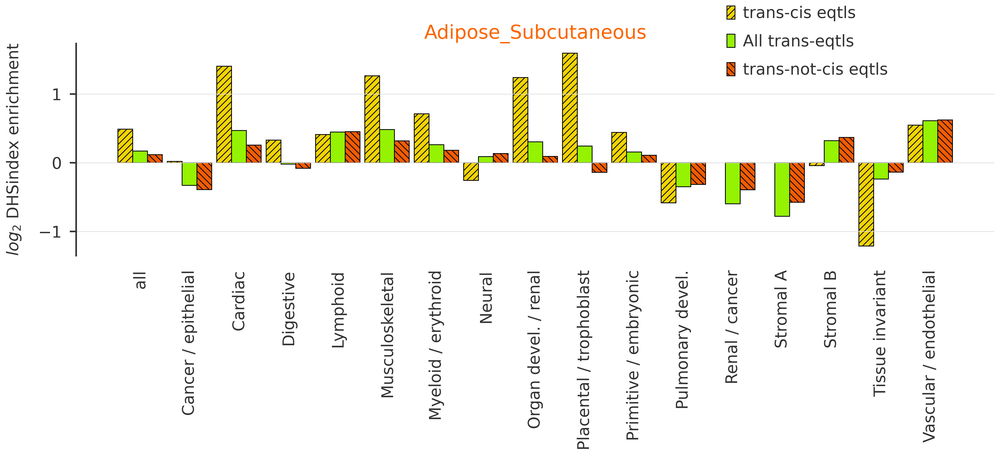

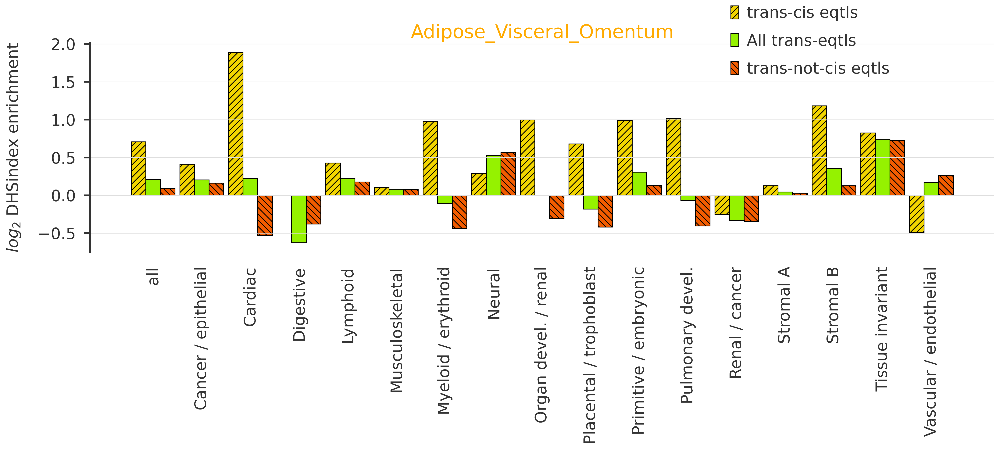

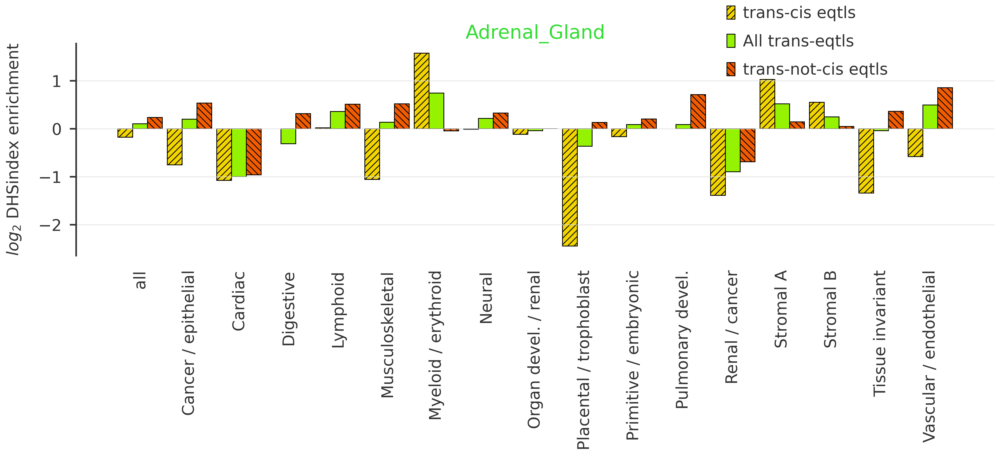

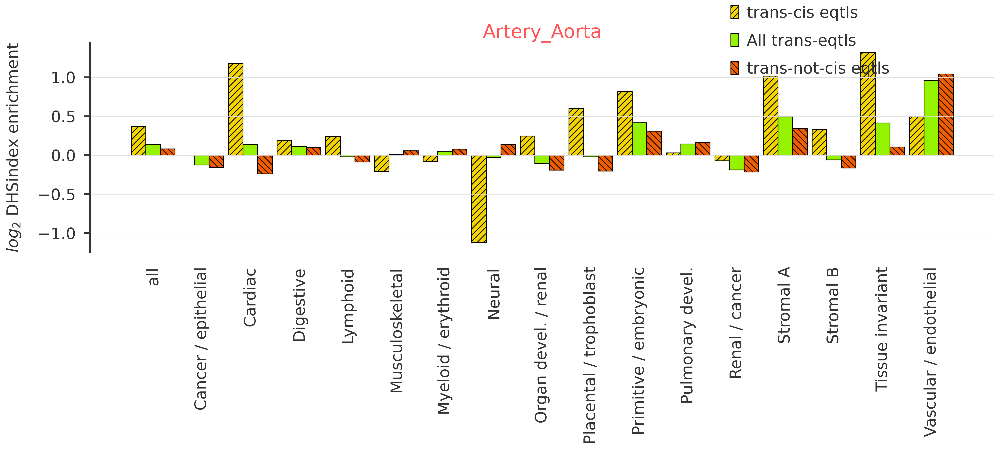

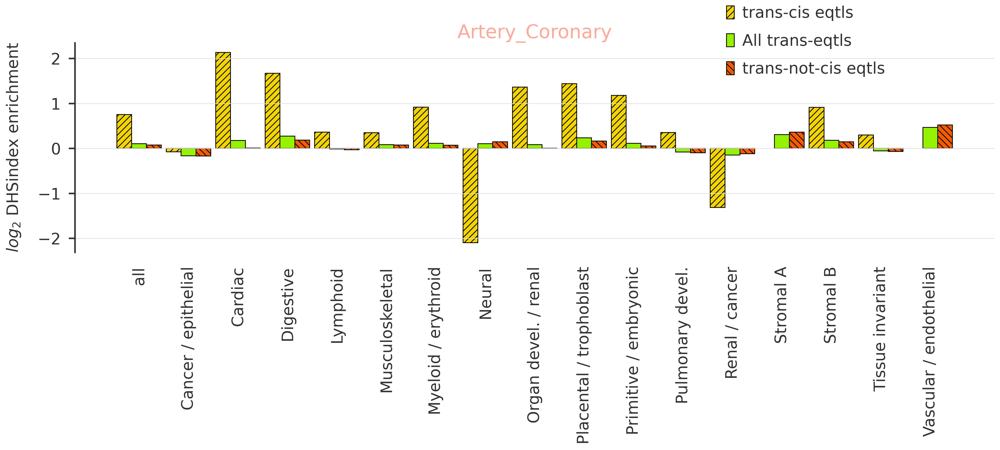

...

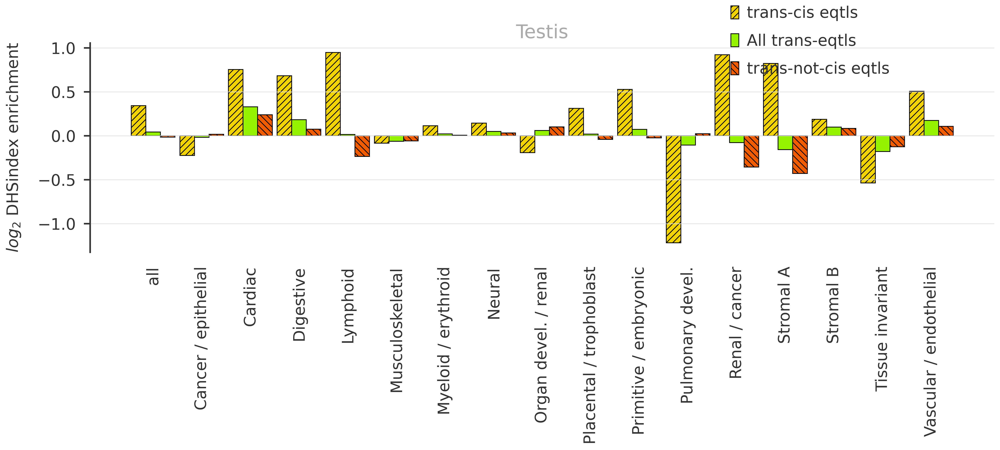

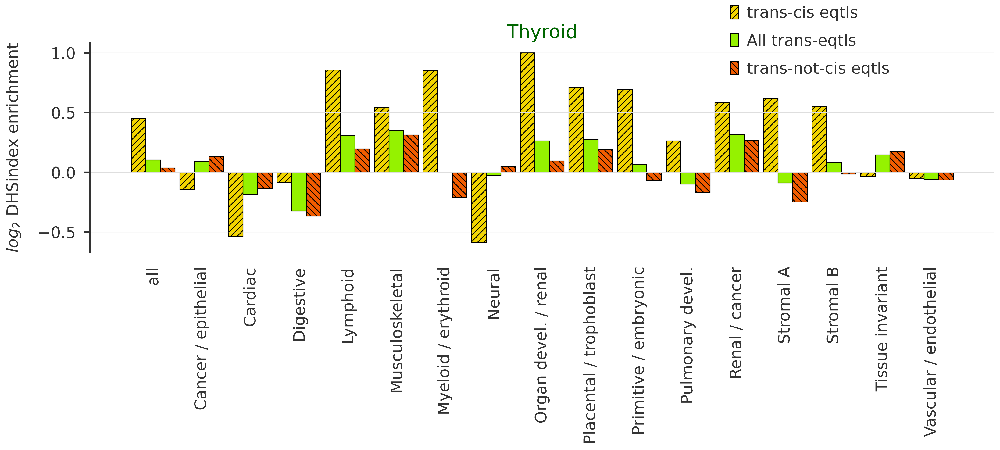

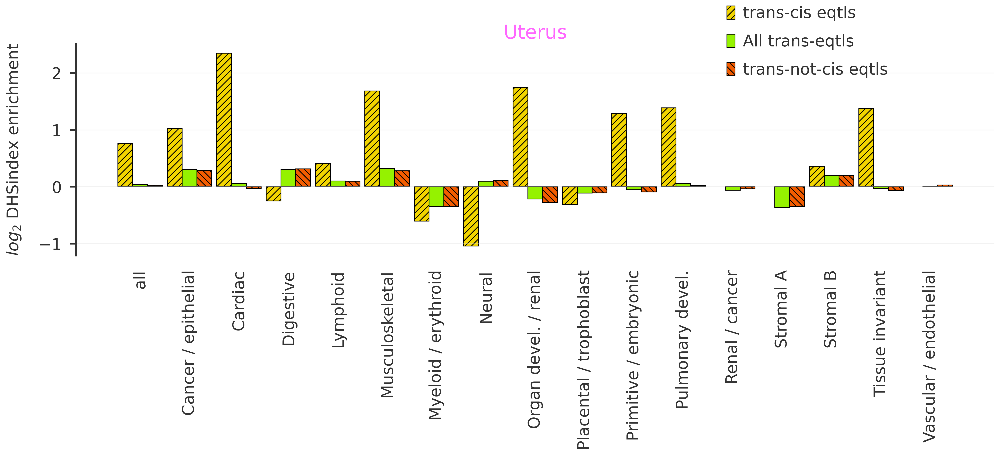

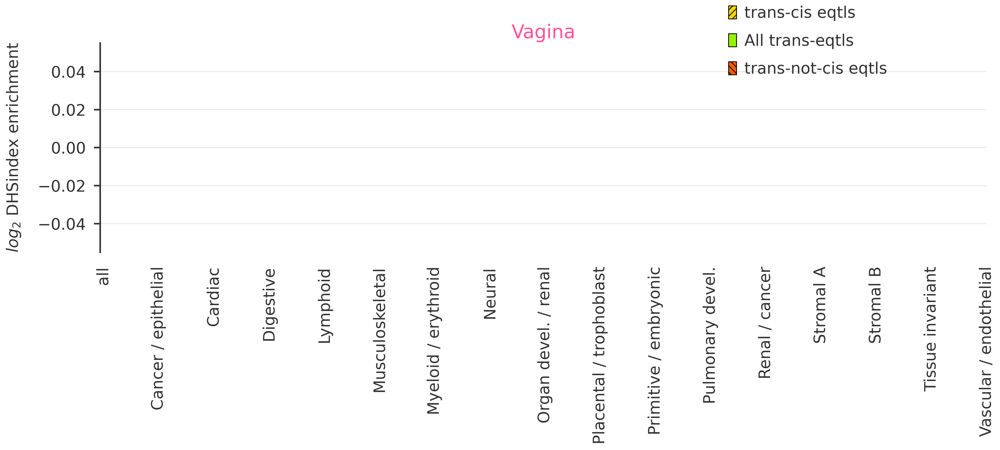

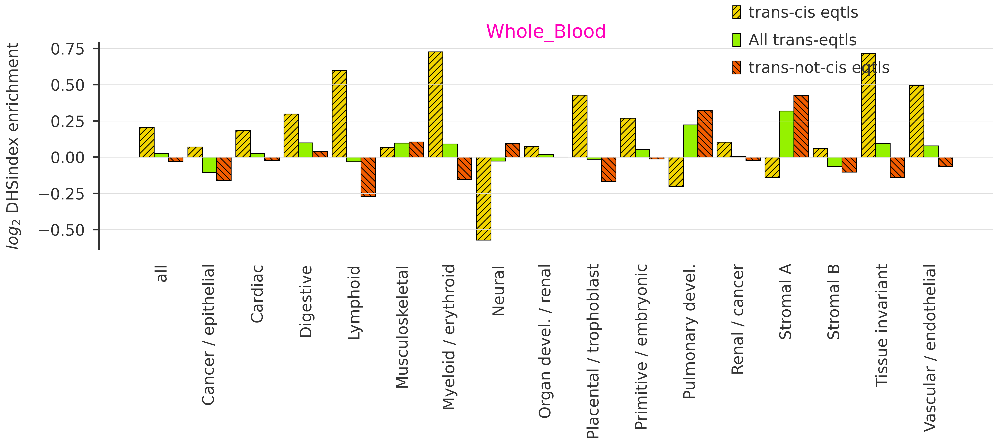

In [94]:
#### Barplot with stripped patterns

import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import mpl_stylesheet
mpl_stylesheet.banskt_presentation(fontfamily = 'latex-clearsans', fontsize = 20, colors = 'banskt', dpi = 300)

def get_log2(X):
    log2X = np.zeros_like(X)
    iX = np.logical_or(np.isnan(X),X == 0)
    log2X[~iX] = np.log2(X[~iX])
    log2X[iX] = np.nan
    return log2X

for tissue in gtex_config["tshorts"]:
    performance = list()
    performance_cis = list()
    performance_notcis = list()

    bar_colors = list()
    bar_heights = list()

    headers = list()    
    for basefile in basefiles:
        enrich_val = storage[dhstype][basefile]["enrichment"]
        data = enrich_val[enrich_val.tissue == tissue].drop("tissue", axis=1)
        if basefile == "trans_cis_eqtl_enrichment.txt":
            performanceL = get_log2(np.array(list(data.values[0])))
        elif basefile == "trans_eqtls_enrichment.txt":
            performance  = get_log2(np.array(list(data.values[0])))
            headers = data.columns
        elif basefile == "trans_not_cis_eqtl_enrichment.txt":
            performanceR = get_log2(np.array(list(data.values[0])))

    figsize = (18, 8)
    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot(111)


    Bwidth=0.3
    x_pos = np.arange(len(headers))
    xL_pos = x_pos - Bwidth
    xR_pos = x_pos + Bwidth

    bar  = ax.bar(x_pos,  performance, align='center', color="#95f200", edgecolor="black", linewidth = 1, width = Bwidth)
    barL = ax.bar(xL_pos, performanceL, align='center', color="#f2d500", edgecolor="black", linewidth = 1, width = Bwidth, hatch='///')
    barR = ax.bar(xR_pos, performanceR, align='center', color="#f25c00", edgecolor="black", linewidth = 1, width = Bwidth, hatch='\\\\\\')

    ax.set_xticks(x_pos)
    ax.set_xticklabels(headers, rotation=90)
    #ax.set_ylabel('$log_2$(enrichment)')
    # ax.set_ylabel(r'$\log_2(\rho_{\mathrm{DHS}})$')
    # xmax = np.around(np.max(performance) + 0.05, decimals = 1)
    # xmin = np.around(np.min(performance) - 0.05, decimals = 1)
    # ax.set_ylim([xmin, xmax])

    ax.tick_params(bottom = False, top = False, left = True, right = False, labelleft = True, labelbottom = True)
    for side, border in ax.spines.items():
        if not side == 'left':
            border.set_visible(False)    

    # # Add p-values beside the bars
    # factor = 1
    # for i, rect in enumerate(bar1):
    #     xpos = rect.get_x() #+ rect.get_width() / 3.5
    #     ypos = rect.get_height()
    #     if enrichment_pvals[i] < 0.05:
    #         ax.text(xpos, ypos + 0.02 * factor, f'*', ha='left', va='center')
    #         if enrichment_pvals[i] < 0.01:
    #             ax.text(xpos, ypos + 0.07 * factor, f'*', ha='left', va='center')
    #             if enrichment_pvals[i] < 0.001:
    #                 ax.text(xpos, ypos + 0.12 * factor, f'*', ha='left', va='center')

    # for i, rect in enumerate(Obar1):
    #     xpos = rect.get_x() #+ rect.get_width() / 3.5
    #     ypos = rect.get_height()
    #     if Oenrichment_pvals[i] < 0.05:
    #         ax.text(xpos, ypos + 0.02 * factor, f'*', ha='left', va='center')
    #         if Oenrichment_pvals[i] < 0.01:
    #             ax.text(xpos, ypos + 0.07 * factor, f'*', ha='left', va='center')
    #             if Oenrichment_pvals[i] < 0.001:
    #                 ax.text(xpos, ypos + 0.12 * factor, f'*', ha='left', va='center')

    ax.grid(which = 'major', axis = 'y', zorder = 0, color = '#DEDEDE')    

    legend_elements = [Patch(facecolor="#f2d500", edgecolor='black', label='trans-cis eqtls', hatch="///"),
                       Patch(facecolor="#95f200", edgecolor='black', label='All trans-eqtls'),
                       Patch(facecolor="#f25c00", edgecolor='black', label='trans-not-cis eqtls', hatch="\\\\\\")]

    ax.legend(handles=legend_elements, loc='lower left', bbox_to_anchor=[.7, .8])
    ax.set_title(gtex_config[tissue]["fullname"], color=gtex_config[tissue]["color"])
    ax.set_ylabel(r'$log_2$ DHSindex enrichment')
    fig.canvas.draw()
    plt.tight_layout()
    plt.savefig(f'plots/dhsindex/gtex_{tissue}_dhsindex_enrichment.pdf', bbox_inches='tight')
    plt.savefig(f'plots/dhsindex/gtex_{tissue}_dhsindex_enrichment.png', bbox_inches='tight')
    plt.show()

In [99]:
storage2 = dict()

#basefile = basefiles[2]

dhstype  = dhstypes[1]
storage2[dhstype]  = dict()
for basefile in basefiles:
    dhs_df = pd.DataFrame([])
    for tissue in gtex_config["tshorts"]:
        filepath = os.path.join(basedir, tissue, dhstype, basefile)
        df = pd.read_csv(filepath, header=0, sep="\t")
        df["tissue"] = tissue
        if dhs_df.shape[0] == 0:
            dhs_df = df
        else:
            dhs_df = pd.concat((dhs_df, df))
            
    storage2[dhstype][basefile] = dhs_df

In [101]:
for basefile in basefiles:
    print(storage2["dhsmulti"][basefile].shape)

(49, 6)
(49, 6)
(49, 6)


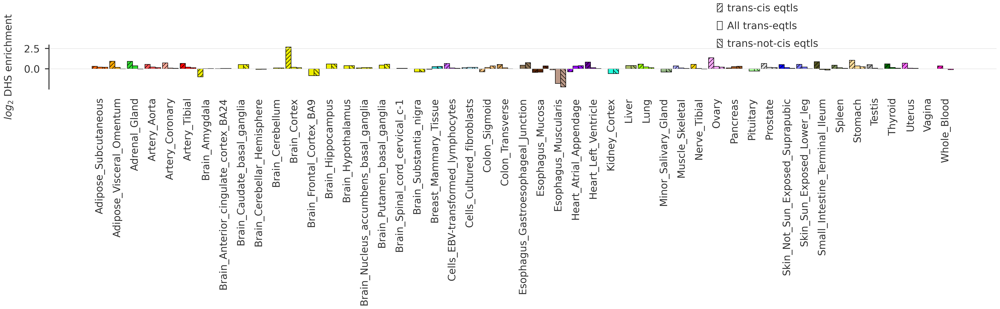

In [112]:
mpl_stylesheet.banskt_presentation(fontfamily = 'latex-clearsans', fontsize = 20, colors = 'banskt', dpi = 300)

def get_log2(X):
    log2X = np.zeros_like(X)
    iX = np.logical_or(np.isnan(X),X == 0)
    log2X[~iX] = np.log2(X[~iX])
    log2X[iX] = np.nan
    return log2X

bar_colors = list()

performance = list()
performance_cis = list()
performance_notcis = list()

xlabels = list()
for tissue in gtex_config["tshorts"]:

    xlabels.append(tissue)
    bar_colors.append(gtex_config[tissue]["color"])

for basefile in basefiles:
    enrich_val = storage2[dhstype][basefile].Enrichment
    if basefile == "trans_cis_eqtl_enrichment.txt":
        performanceL = get_log2(np.array(list(enrich_val)))
    elif basefile == "trans_eqtls_enrichment.txt":
        performance  = get_log2(np.array(list(enrich_val)))
    elif basefile == "trans_not_cis_eqtl_enrichment.txt":
        performanceR = get_log2(np.array(list(enrich_val)))
        

figsize = (28, 8)
fig = plt.figure(figsize = figsize)
ax = fig.add_subplot(111)


Bwidth=0.3
x_pos = np.arange(len(xlabels))
xL_pos = x_pos - Bwidth
xR_pos = x_pos + Bwidth

bar  = ax.bar(x_pos,  performance, align='center', color=bar_colors, edgecolor="black", linewidth = 1, width = Bwidth)
barL = ax.bar(xL_pos, performanceL, align='center', color=bar_colors, edgecolor="black", linewidth = 1, width = Bwidth, hatch='///')
barR = ax.bar(xR_pos, performanceR, align='center', color=bar_colors, edgecolor="black", linewidth = 1, width = Bwidth, hatch='\\\\\\')

ax.set_xticks(x_pos)
ax.set_xticklabels([gtex_config[x]["fullname"] for x in xlabels], rotation=90)
#ax.set_ylabel('$log_2$(enrichment)')
# ax.set_ylabel(r'$\log_2(\rho_{\mathrm{DHS}})$')
# xmax = np.around(np.max(performance) + 0.05, decimals = 1)
# xmin = np.around(np.min(performance) - 0.05, decimals = 1)
# ax.set_ylim([xmin, xmax])

ax.tick_params(bottom = False, top = False, left = True, right = False, labelleft = True, labelbottom = True)
for side, border in ax.spines.items():
    if not side == 'left':
        border.set_visible(False)    

# # Add p-values beside the bars
# factor = 1
# for i, rect in enumerate(bar1):
#     xpos = rect.get_x() #+ rect.get_width() / 3.5
#     ypos = rect.get_height()
#     if enrichment_pvals[i] < 0.05:
#         ax.text(xpos, ypos + 0.02 * factor, f'*', ha='left', va='center')
#         if enrichment_pvals[i] < 0.01:
#             ax.text(xpos, ypos + 0.07 * factor, f'*', ha='left', va='center')
#             if enrichment_pvals[i] < 0.001:
#                 ax.text(xpos, ypos + 0.12 * factor, f'*', ha='left', va='center')

# for i, rect in enumerate(Obar1):
#     xpos = rect.get_x() #+ rect.get_width() / 3.5
#     ypos = rect.get_height()
#     if Oenrichment_pvals[i] < 0.05:
#         ax.text(xpos, ypos + 0.02 * factor, f'*', ha='left', va='center')
#         if Oenrichment_pvals[i] < 0.01:
#             ax.text(xpos, ypos + 0.07 * factor, f'*', ha='left', va='center')
#             if Oenrichment_pvals[i] < 0.001:
#                 ax.text(xpos, ypos + 0.12 * factor, f'*', ha='left', va='center')

ax.grid(which = 'major', axis = 'y', zorder = 0, color = '#DEDEDE')    

legend_elements = [Patch(facecolor="w", edgecolor='black', label='trans-cis eqtls', hatch="///"),
                   Patch(facecolor="w", edgecolor='black', label='All trans-eqtls'),
                   Patch(facecolor="w", edgecolor='black', label='trans-not-cis eqtls', hatch="\\\\\\")]

ax.legend(handles=legend_elements, loc='lower left', bbox_to_anchor=[.7, .8])
ax.set_ylabel(r'$log_2$ DHS enrichment')
fig.canvas.draw()
plt.tight_layout()
plt.savefig(f'plots/dhsmulti/gtex_dhsmulti_enrichment.pdf', bbox_inches='tight')
plt.savefig(f'plots/dhsmulti/gtex_dhsmulti_enrichment.png', bbox_inches='tight')
plt.show()

# Below is unused code to make heatmaps

In [55]:
import fastcluster
from scipy.cluster import hierarchy

def calculate_linkage(matrix, rows = False, cols = False):
    if rows:
        data = matrix
        row_linkage = fastcluster.linkage_vector(data.fillna(0).values,
                                   method='single',
                                   metric="euclidean")
        # row_linkage = hierarchy.linkage(data.fillna(0), method="average", metric='euclidean')

        row_dendrogram = hierarchy.dendrogram(row_linkage, no_plot=True, color_threshold=-np.inf)
        row_reordered_ind = row_dendrogram['leaves']

    if cols:
        data = matrix.T
        col_linkage = fastcluster.linkage_vector(data.fillna(0).values,
                                   method='single',
                                   metric="euclidean")
        # col_linkage = hierarchy.linkage(data.fillna(0), method="average", metric='euclidean')
    
        col_dendrogram = hierarchy.dendrogram(col_linkage, no_plot=True, color_threshold=-np.inf)
        col_reordered_ind = col_dendrogram['leaves']
        
    if rows and cols:
        return matrix.iloc[row_reordered_ind, col_reordered_ind]
    if cols:
        return matrix.iloc[:, col_reordered_ind]
    if rows:
        return matrix.iloc[row_reordered_ind, :]
    
# data = calculate_linkage(dhsindex_enrch.T, rows=True, cols=True)

In [ ]:
# Heatmap with Seaborn

import matplotlib
# matplotlib.use("Agg")
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns; sns.set()

fig = plt.figure(figsize=(20,8), dpi=300)  
ax  = fig.add_subplot(111)
# cbar_ax = fig.add_axes([.905, .3, .05, .3])
cmap = plt.get_cmap("RdBu_r")

mymask = pd.isna(data)

h = sns.heatmap(data,
                cmap=cmap, #"RdBu_r",
                robust=True,
                linewidths=.5,
                center=.0,
                cbar_kws={'label': 'enrichment', 'shrink':0.45,
                          'extend':'both',
                          'pad':0.01,
                          'aspect':15},
                ax=ax,
                mask=mymask)

### Use this to change the colorbar ticks and labels
# cbar=plt.colorbar(ax)
# cbar.set_yticklabels(["a","a","a","a","a","a"])
# h.figure.axes[1].set_yticklabels(["-2","-1","0","1","2","3","> 4"])


# ax.set_yticklabels(data.index, rotation=90) #, ha='right')
# ax.set_xticklabels(data.columns, rotation=90) #, ha='right')

# Countour lines
ax.hlines([ax.get_ylim()[1]]  , *ax.get_xlim(), color='gray', lw=4)
ax.hlines([ax.get_ylim()[0]]  , *ax.get_xlim(), color='gray', lw=4)
ax.vlines([0,ax.get_xlim()[1]], ax.get_ylim()[0]-1, ax.get_ylim()[0], color='gray', lw=4)
ax.vlines([0,ax.get_xlim()[1]], ax.get_ylim()[0]-1, ax.get_ylim()[1], color='gray', lw=4)

    
# my_colors=[tissue_colors[t] for t in data.index]
# ax.set_aspect('equal')
# for t, X in zip(data.index, ax.get_yticks()):
#     ax.add_patch(patches.Circle((-0.5, X), radius=.3,
#                                  fill=True,clip_on=False, color=tissue_colors[t]))
    
# labels = ax.get_yticklabels()
# for label in labels:
#     label.set_x(label.get_position()[1] - 0.07 ) 

ax.set_aspect('equal')
# my_colors=[tissue_colors[t] for t in data.columns]
for c, X in zip(data.columns, ax.get_xticks()):
    ax.add_patch(patches.Circle((X, len(data.index)+0.5), radius=.3,
                                 fill=True, clip_on=False, color=tissue_colors[c]))
    
#     X-0.4, len(data.index)+0.3)

# labels = ax.get_yticklabels()
# ax.set_yticklabels([tissue_names[l.get_text()] for l in labels], rotation=0, ha='right')

labels = ax.get_xticklabels()
new_labels = list()
for l in labels:
    label = l.get_text()
    if label in tissue_names:
        new_labels.append(tissue_names[label])
    else:
        new_labels.append(label)
ax.set_xticklabels(new_labels, rotation=90, ha='center', va='top') #, rotation_mode="anchor")

# custom_legend = [ patches.Rectangle((0,0), width=1., height=1., facecolor="#ff960d", label='Sample Covariates') ,
#                   patches.Rectangle((0,0), width=1., height=1., facecolor="#00c465", label="Subject Covariates"), 
#                   patches.Rectangle((0,0), width=1., height=1., facecolor="#7223e8", label="Genotype and Others")]

# ax.legend(bbox_to_anchor=(-0.2, -0.35, -0.5, 0.),borderaxespad=0., handles=custom_legend, loc='lower left')
# plt.savefig("../plots/DHSindex_figure.png", bbox_inches = 'tight')
# plt.savefig("../plots/DHSindex_figure.pdf", bbox_inches = 'tight')

plt.show()


In [ ]:
## Heatmap classic

import matplotlib.pyplot as plt
import matplotlib

import mpl_stylesheet
from mpl_toolkits.axes_grid1 import make_axes_locatable
import utils
mpl_stylesheet.banskt_presentation(fontfamily = 'latex-clearsans', fontsize = 18, colors = 'banskt', dpi = 300)

def get_log2(X):
    log2X = np.zeros_like(X)
    iX = np.logical_or(np.isnan(X),X == 0)
    log2X[~iX] = np.log2(X[~iX])
    log2X[iX] = np.nan
    return log2X

# whichplots = ['k562', 'k562_control', 'hpeg2', 'hpeg2_control']
whichplots = ['k562', 'hepg2']
whichtissues = [x for x in list(enrich_df.columns) if x not in brain_tissues]

enrich_arr = np.array(enrich_df.loc[whichplots, whichtissues], dtype = np.float)
log2enrich_arr = get_log2(enrich_arr)
tnan_ix = np.all(np.isnan(log2enrich_arr), axis = 0)

data = log2enrich_arr[:, ~tnan_ix]
count_data = np.array(counts_df.loc[whichplots, whichtissues])[:, ~tnan_ix]
xradii  = [.2 for x in whichtissues]
xlabels = [tissue_names[x] for i, x in enumerate(whichtissues) if not tnan_ix[i]]
xcolors = [tissue_colors[x] for i, x in enumerate(whichtissues) if not tnan_ix[i]]

fig = plt.figure(figsize = (18, 6))
ax1 = fig.add_subplot(111)

norm = matplotlib.colors.DivergingNorm(vmin=-1, vcenter=0., vmax=1)
cmap = plt.get_cmap("coolwarm")
norm = matplotlib.colors.DivergingNorm(vmin=-2.5, vcenter=0., vmax=2.5)
cmap.set_bad('w')

im = ax1.imshow(data, cmap = cmap, norm = norm)
ax1.tick_params(bottom = False, top = False, left = False, right = False, labelleft = False, labelbottom = True)
for side, border in ax1.spines.items():
    border.set_visible(False)
ax1.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
ax1.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
ax1.grid(which="minor", color="w", linestyle='-', linewidth=3)
xtickpos = np.arange(data.shape[1])
for i, xtick in enumerate(xtickpos):
    ax1.add_patch(matplotlib.patches.Circle((xtick, data.shape[0] + 0.05), radius=xradii[i], 
                                            fill=True,clip_on=False, color=xcolors[i]))
ax1.set_xticks(xtickpos)
ax1.set_xticklabels(xlabels, rotation = 90)
for label in ax1.get_xticklabels():
    label.set_y(label.get_position()[1] - 0.25 )

# create an axes on the right side of ax. The width of cax will be 5%
# of ax and the padding between cax and ax will be fixed at 0.05 inch.
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="1%", pad=0.2)
cbar = plt.colorbar(im, cax=cax, ticks=[-2, -1, 0, 1, 2], extend = 'both')
#cbar = plt.colorbar(im, cax = cax)
cbar.ax.set_yticklabels(['≤ -2', '', '0', '', '≥ 2'])  # vertically oriented colorbar
cbar.outline.set_edgecolor('white')

ax2 = divider.append_axes("left", size="10%", pad=0.05)
boxcolor = '#803E75'
boxface = f'#{boxcolor[1:]}59' #https://stackoverflow.com/questions/15852122/hex-transparency-in-colors
bgcolor = '#333333'
etots = list()
fnlabels = list()
xlims = [-0.3, 2.3]
# Barplot from top to bottom (reverse of default)
for i in range(len(whichplots)):
    j = len(whichplots) - i - 1
    fn_etot = data[j, :]
    etots.append(fn_etot[~np.isnan(fn_etot)])
    fnlabels.append(whichplots[j])
    if i%2 == 0:
        ax2.fill_between(xlims, [i + 1.5, i + 1.5], [i + 0.5, i + 0.5], facecolor='#EEEEEE', lw = 0)
medianprops = dict(linewidth=2, color = boxcolor)
whiskerprops = dict(linewidth=2, color = boxface)
boxprops = dict(linewidth=2, color = boxcolor, facecolor = boxface)
ax2.boxplot(etots, vert=False, showfliers = False, showcaps = False, widths=0.3,
            patch_artist=True, notch = False,
            boxprops = boxprops, medianprops = medianprops, whiskerprops = whiskerprops)

ax2.axvline(0, ls = 'dashed', color = '#333333')
ax2.set_xlim(xlims)
ax2.set_xticks(np.arange(int(xlims[0]), int(xlims[1]) + 1))
ax2.set_yticks(np.arange(data.shape[0])+1)
ax2.set_yticklabels([l.upper() for l in fnlabels])
ax2.tick_params(bottom = True, top = False, left = False, right = False, labelleft = True, labelbottom = True)
ax2.set_xlabel(r'$\log_2(\rho)$')

for side, border in ax2.spines.items():
    if side != 'bottom':
        border.set_visible(False)


# for i in range(data.shape[0]):
#     for j in range(data.shape[1]):
#         text = ax1.text(j, i, "{:.1f}".format(data[i, j]),
#                        ha="center", va="center", color="w")   
        
for i in range(data.shape[0]):
    for j in range(data.shape[1]):
        text = ax1.text(j, i, "{:d}".format(count_data[i, j]),
                       ha="center", va="center", color="w")  
        
plt.tight_layout()
# plt.savefig(f'../plots/gtex_trans_eqtl_raqtl_enrichment_{config}.pdf', bbox_inches='tight')
# plt.savefig(f'../plots/gtex_trans_eqtl_raqtl_enrichment_{config}.png', bbox_inches='tight')
plt.show()